<a href="https://colab.research.google.com/github/CamiloGR25/EntrenamientoAI/blob/main/Entrenamiendo_de_un_modelo_de_reconocimiento.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!unzip dataset_temp.zip

Archive:  dataset_temp.zip
   creating: dataset_temp/a/
  inflating: dataset_temp/a/frame_0015.jpg  
  inflating: dataset_temp/a/frame_0016.jpg  
  inflating: dataset_temp/a/frame_0017.jpg  
  inflating: dataset_temp/a/frame_0018.jpg  
  inflating: dataset_temp/a/frame_0019.jpg  
  inflating: dataset_temp/a/frame_0020.jpg  
  inflating: dataset_temp/a/frame_0021.jpg  
  inflating: dataset_temp/a/frame_0022.jpg  
  inflating: dataset_temp/a/frame_0023.jpg  
  inflating: dataset_temp/a/frame_0024.jpg  
  inflating: dataset_temp/a/frame_0025.jpg  
  inflating: dataset_temp/a/frame_0026.jpg  
  inflating: dataset_temp/a/frame_0027.jpg  
  inflating: dataset_temp/a/frame_0028.jpg  
  inflating: dataset_temp/a/frame_0029.jpg  
  inflating: dataset_temp/a/frame_0030.jpg  
  inflating: dataset_temp/a/frame_0031.jpg  
  inflating: dataset_temp/a/frame_0032.jpg  
  inflating: dataset_temp/a/frame_0033.jpg  
  inflating: dataset_temp/a/frame_0034.jpg  
  inflating: dataset_temp/a/frame_0035.jpg  

130 archivos de la carpeta j
130 archivos de la carpeta d
130 archivos de la carpeta r
130 archivos de la carpeta y
130 archivos de la carpeta k
130 archivos de la carpeta b
130 archivos de la carpeta z
130 archivos de la carpeta h
130 archivos de la carpeta s
130 archivos de la carpeta n
130 archivos de la carpeta q
130 archivos de la carpeta eye
130 archivos de la carpeta x
130 archivos de la carpeta a
130 archivos de la carpeta f
130 archivos de la carpeta i
130 archivos de la carpeta e
130 archivos de la carpeta c
130 archivos de la carpeta m
130 archivos de la carpeta g


<ipython-input-2-f14c6e26dd78>:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15,15))


130 archivos de la carpeta w
130 archivos de la carpeta l
130 archivos de la carpeta u
130 archivos de la carpeta o
130 archivos de la carpeta t
130 archivos de la carpeta v
130 archivos de la carpeta p
Found 2457 images belonging to 27 classes.
Found 1053 images belonging to 27 classes.


<ipython-input-2-f14c6e26dd78>:76: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,5,i+1)


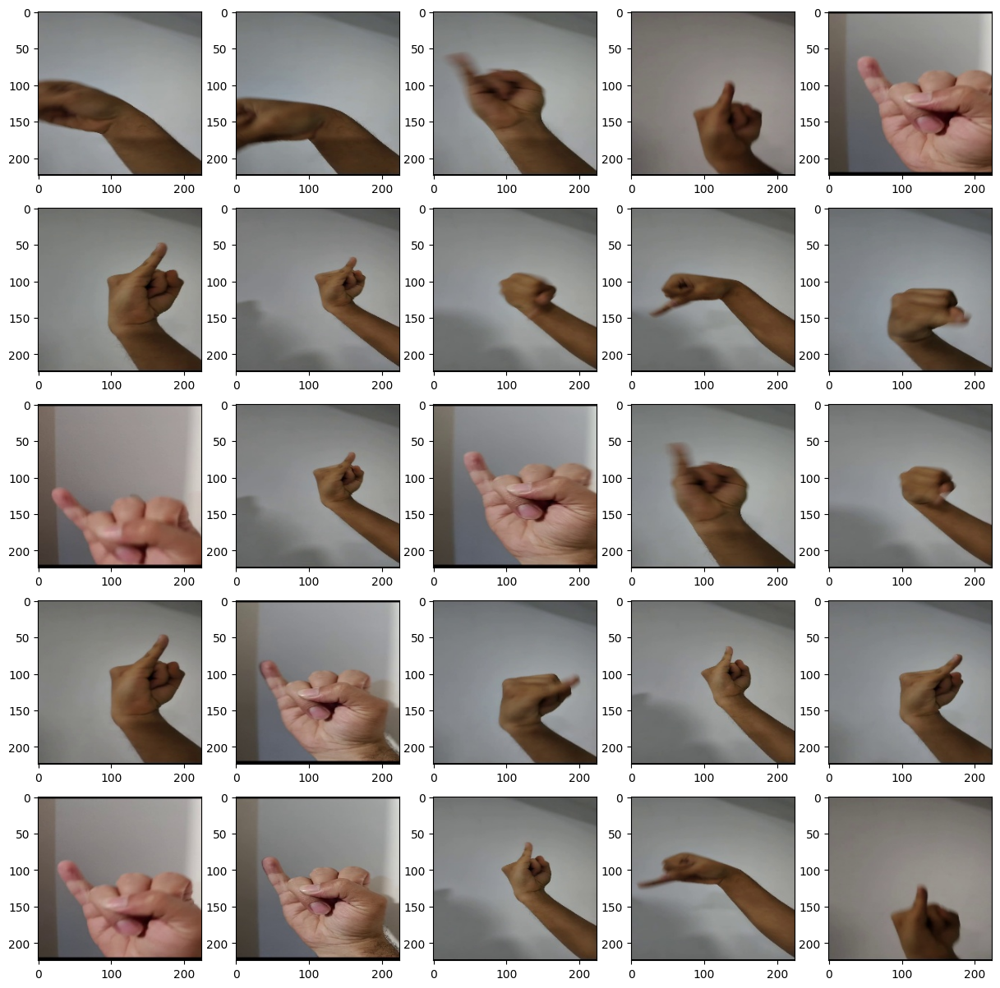

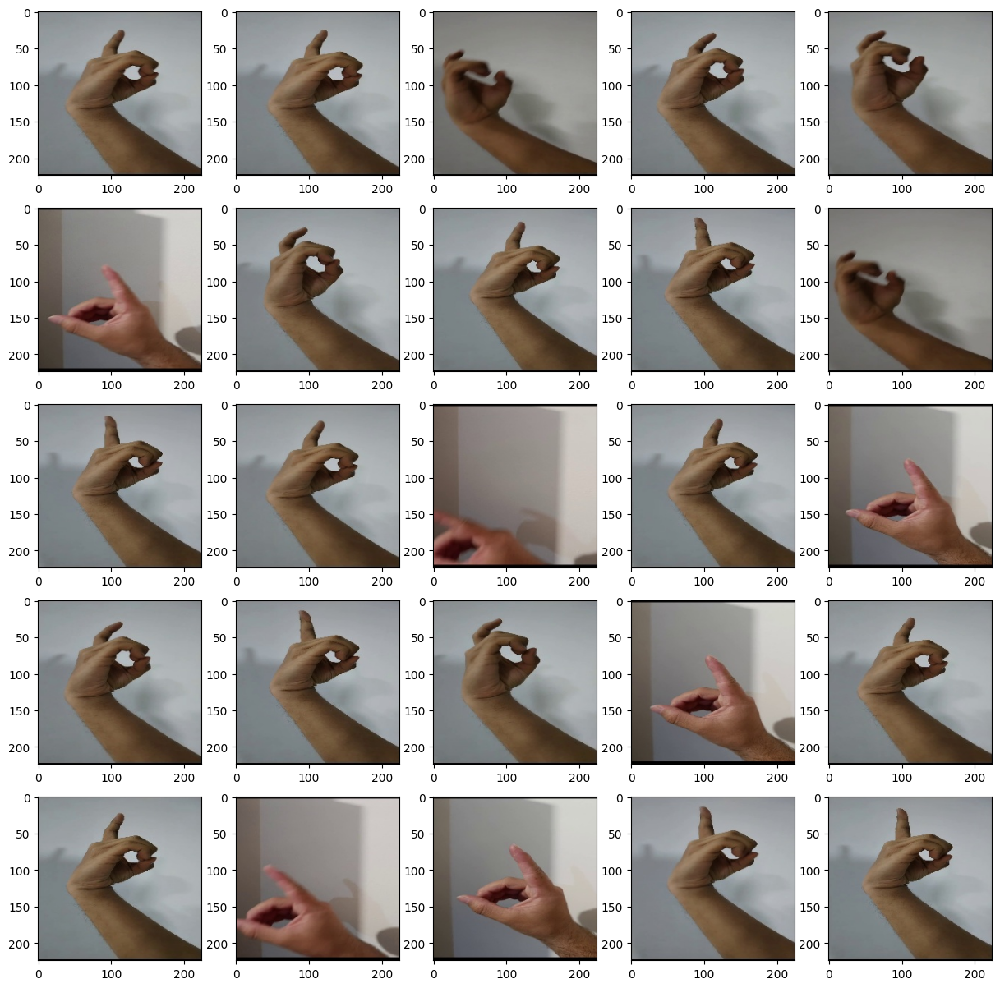

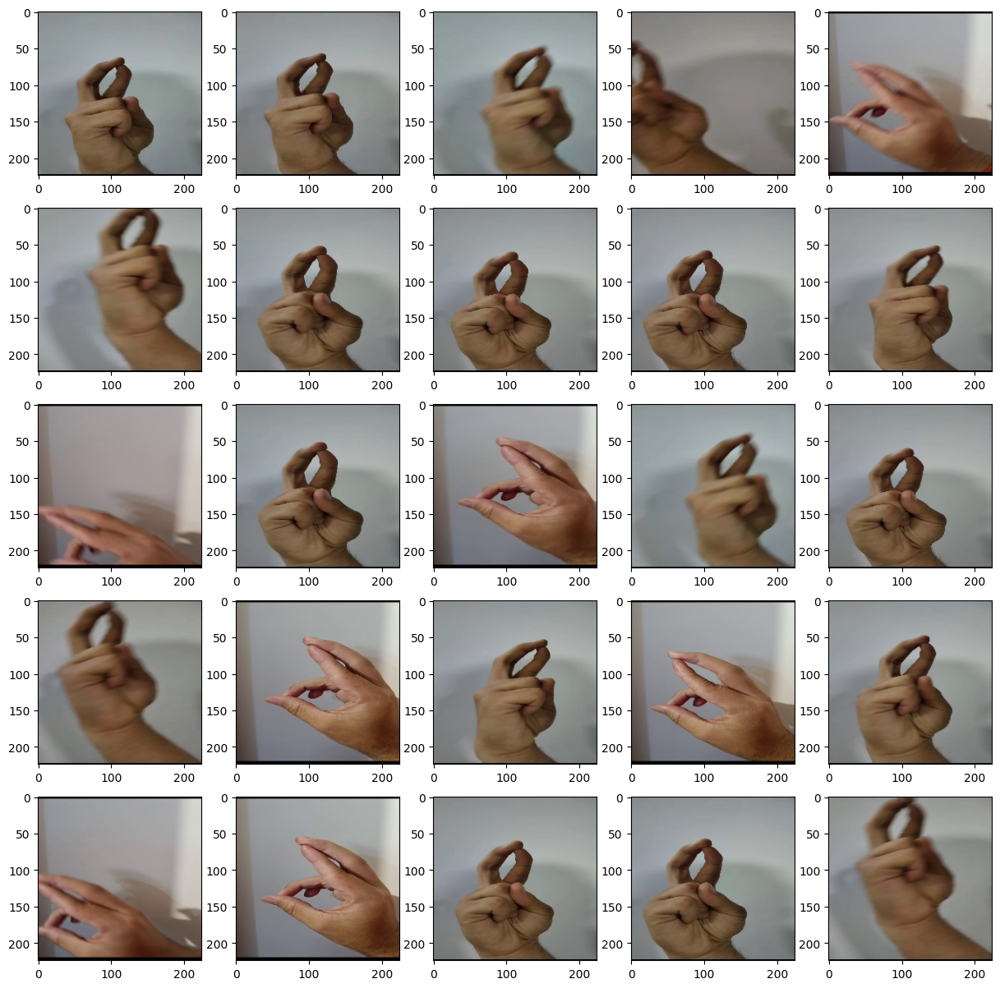

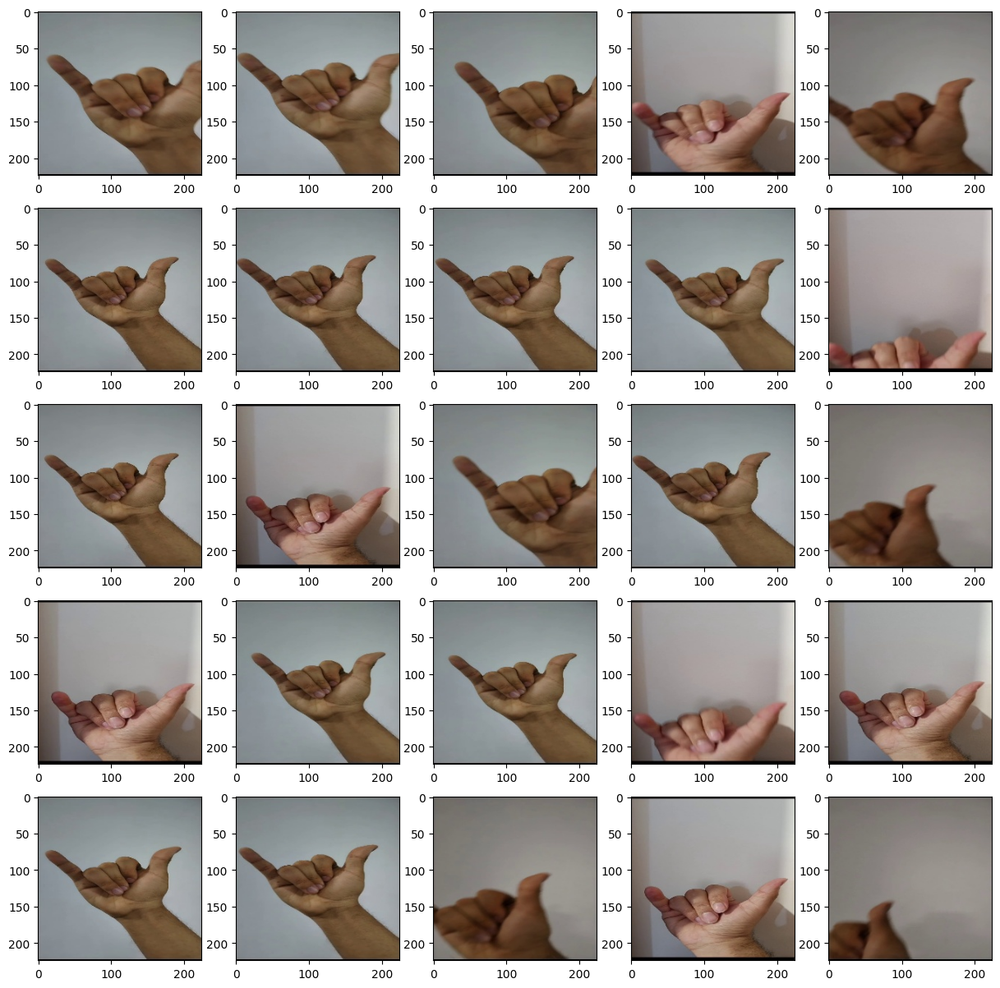

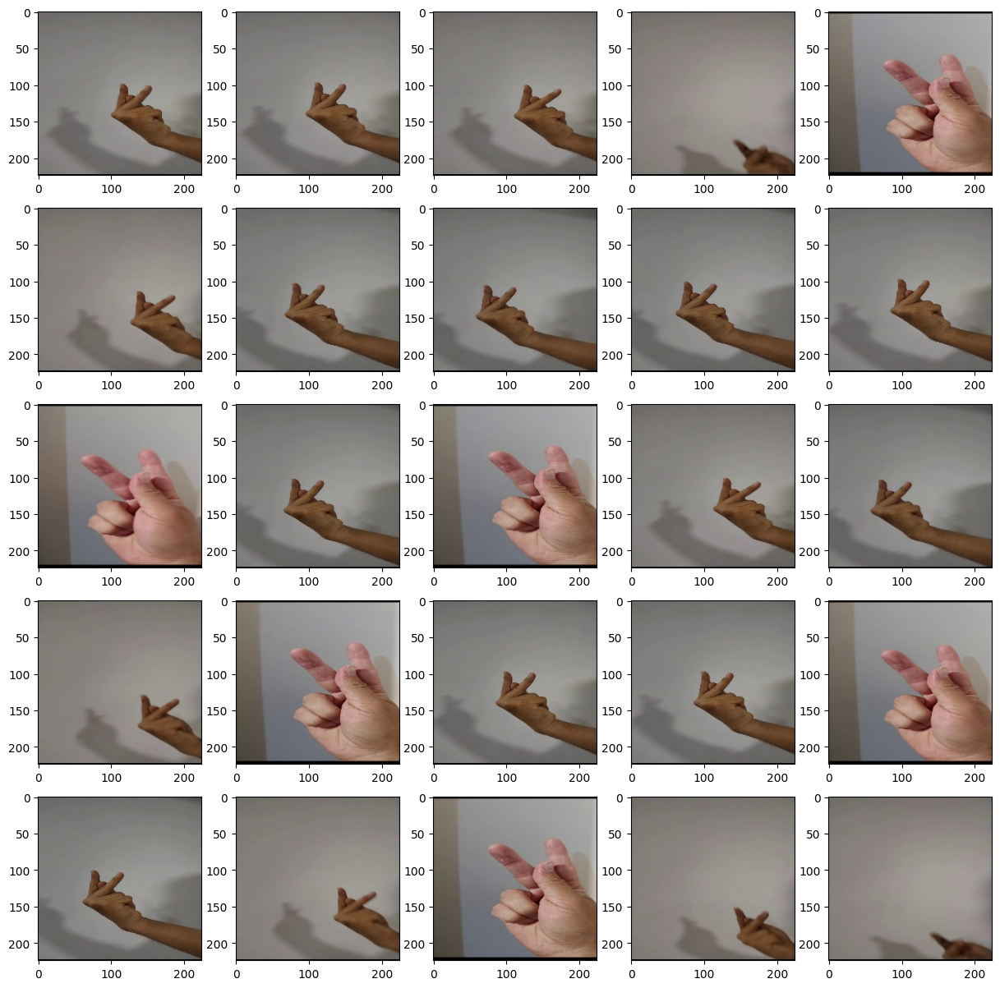

...

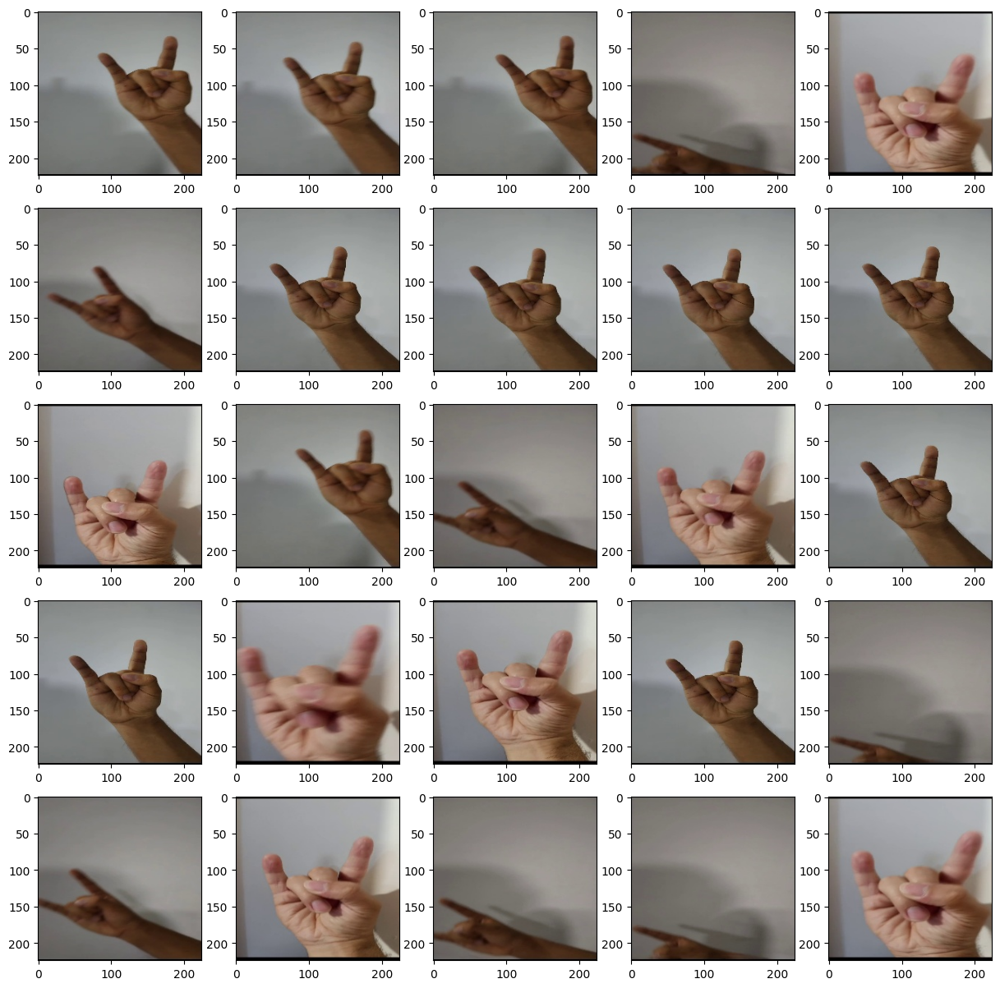

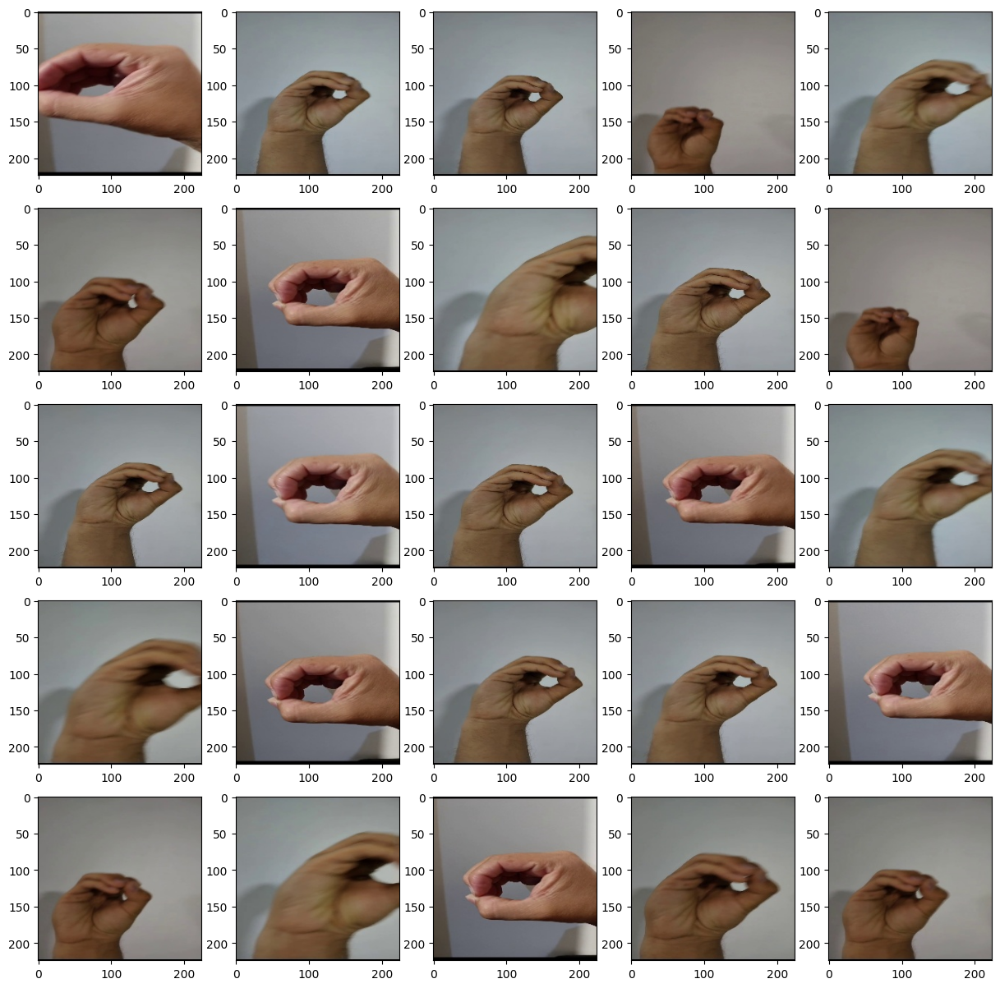

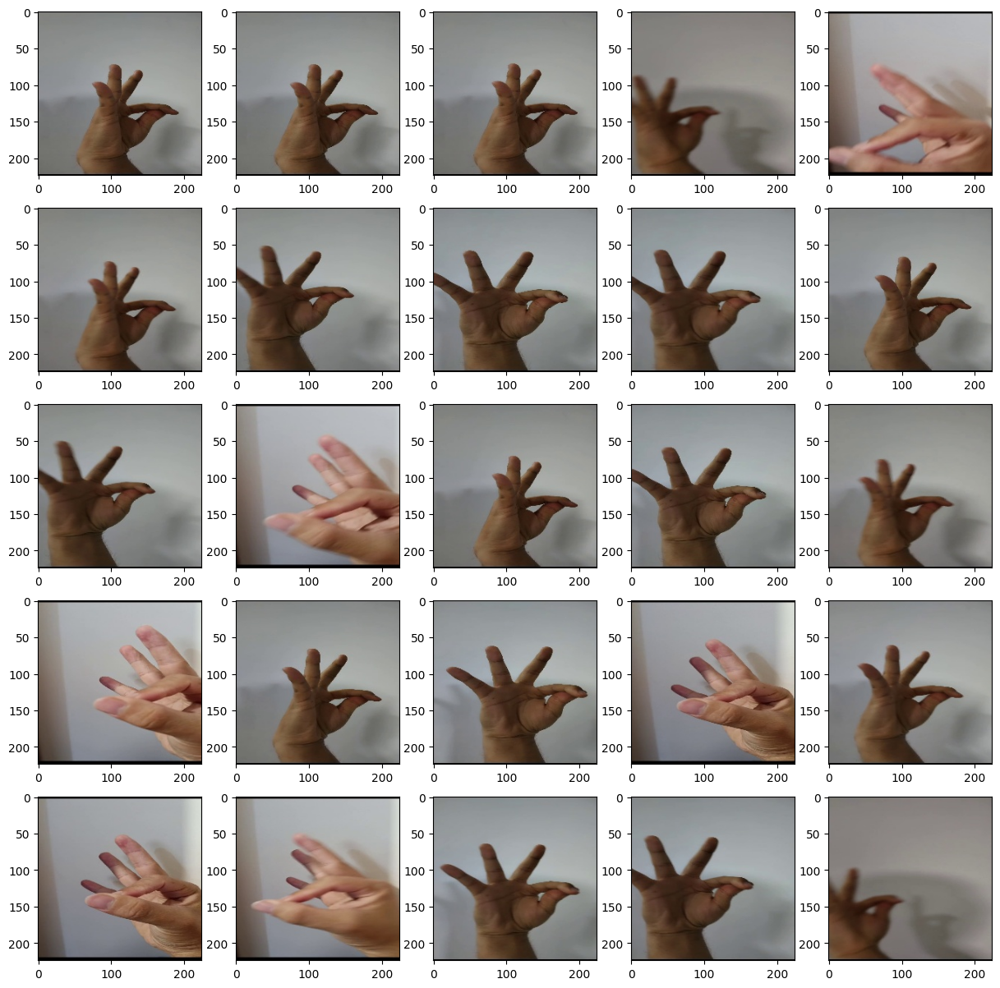

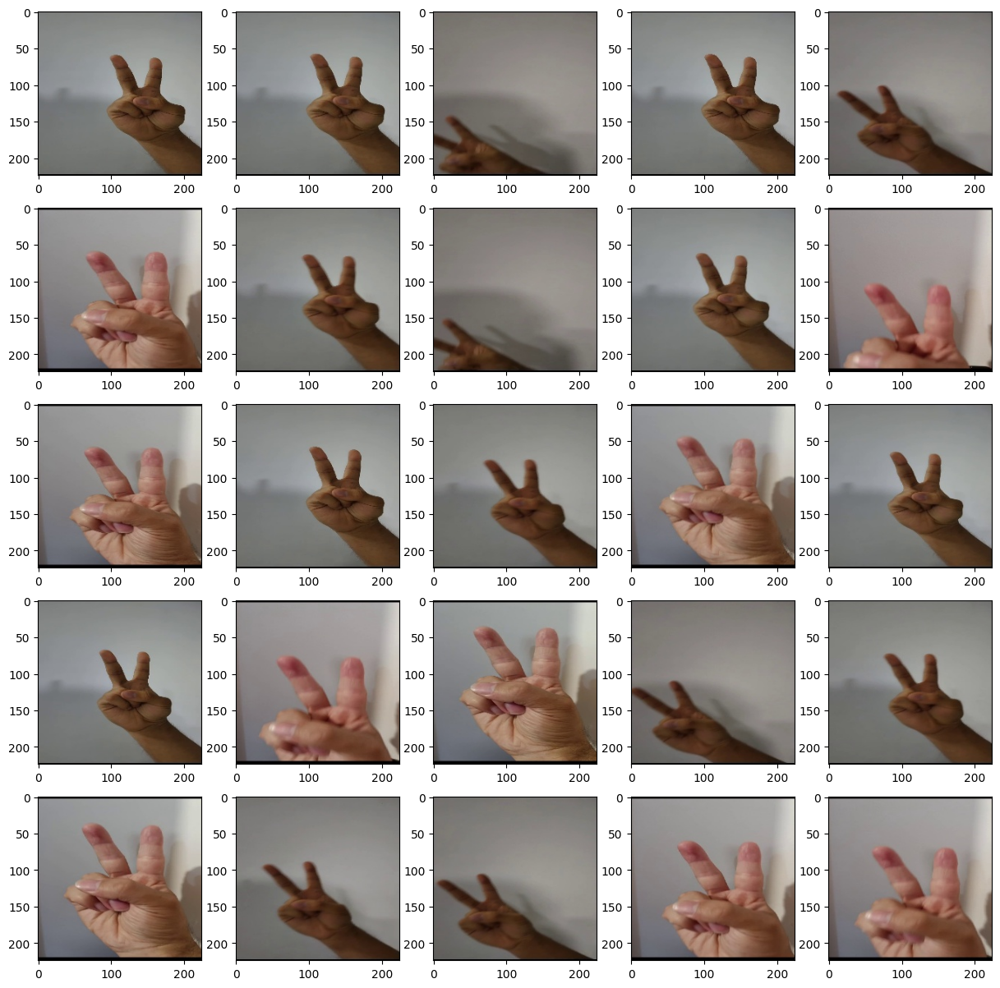

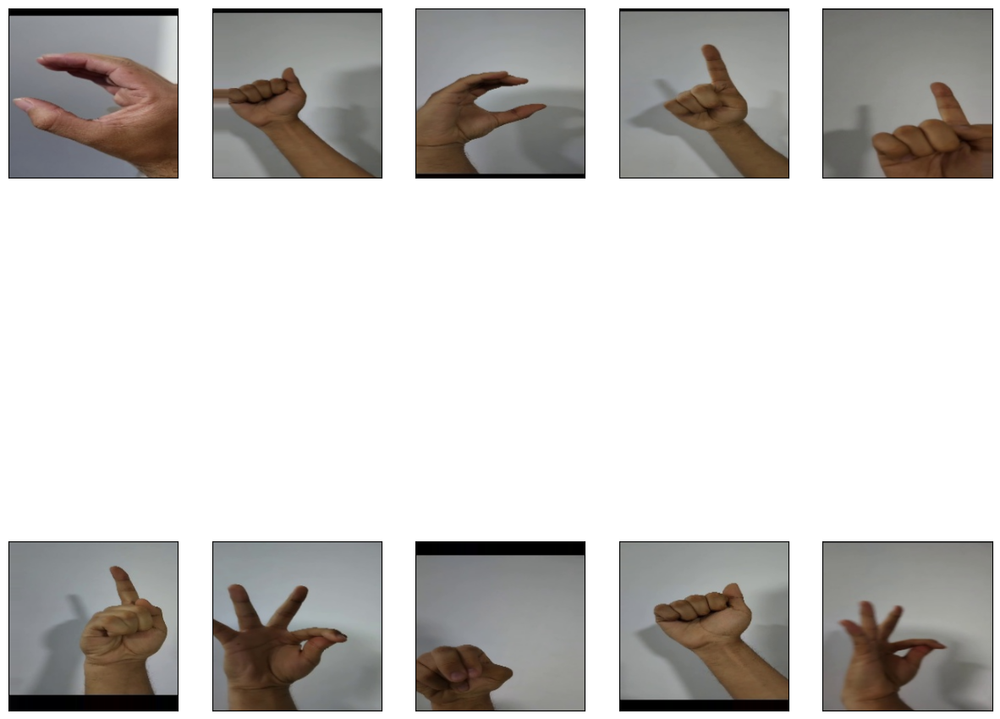

In [2]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import shutil
#Aumento de datos con ImageDataGenerator
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np


def imprimir(nombreCarpeta):

    plt.figure(figsize=(15,15))

    carpeta = 'dataset_temp/'+nombreCarpeta
    imagenes = os.listdir(carpeta)

    for i, nombreimg in enumerate(imagenes[:25]):
        plt.subplot(5,5,i+1)
        imagen = mpimg.imread(carpeta + '/' + nombreimg)
        plt.imshow(imagen)

def enviarDatos(nombreCarpeta):

    carpeta_fuente = 'dataset_temp/'+nombreCarpeta
    carpeta_destino = 'dataset/'+nombreCarpeta
    os.makedirs(carpeta_destino,exist_ok=True)
    imagenes = os.listdir(carpeta_fuente)

    for i, nombreimg in enumerate(imagenes):
        # Verifica si la extensión del archivo es .jpg o .png
        if nombreimg.lower().endswith(('.jpg', '.png')):
            if i < 130:
                # Copia solo las imágenes con extensiones .jpg o .png
                shutil.copy(os.path.join(carpeta_fuente, nombreimg), os.path.join(carpeta_destino, nombreimg))

def contar(nombreCarpeta):
    carpeta='dataset/'+nombreCarpeta
    archivos=os.listdir(carpeta)
    numArchivos=len(archivos)
    print(str(numArchivos)+" archivos de la carpeta "+nombreCarpeta)

def aumentarDataSet():
    #Crear el dataset generador
    datagen = ImageDataGenerator(
        rescale=1. / 255,
        rotation_range = 0,
        width_shift_range = 0.1,
        height_shift_range = 0.1,
        shear_range = 0.5,
        zoom_range = [0.9, 1],
        validation_split=0.3 #30% para pruebas
    )

    #Generadores para sets de entrenamiento y pruebas
    data_gen_entrenamiento = datagen.flow_from_directory(
        'dataset/',
        target_size=(224,224),
        batch_size=32,
        shuffle=True,
        subset='training',
        classes=['a', 'b', 'c', 'd', 'e','eye','f','g','h','i','j','k','l','m','n','o', 'p', 'q', 'r', 's', 't','u', 'v','w','x', 'y','z']
        )
    data_gen_pruebas = datagen.flow_from_directory(
        'dataset/',
        target_size=(224,224),
        batch_size=32,
        shuffle=True,
        subset='validation',
        classes=['a', 'b', 'c', 'd', 'e','eye','f','g','h','i','j','k','l','m','n','o', 'p', 'q', 'r', 's', 't','u', 'v','w','x', 'y','z']
        )


    #Imprimir 10 imagenes del generador de entrenamiento
    for imagen, etiqueta in data_gen_entrenamiento:
        for i in range(10):
            plt.subplot(2,5,i+1)
            plt.xticks([])
            plt.yticks([])
            plt.imshow(imagen[i])
        break
    plt.show()

    return data_gen_entrenamiento, data_gen_pruebas


nombresCarpetas = os.listdir("dataset_temp") #guardar todos los archivos de la carpeta
#print(nombresCarpetas)
for nombreCarpeta in nombresCarpetas: #archivo por archivo
    imprimir(nombreCarpeta)
    #print(nombreCarpeta)
    enviarDatos(nombreCarpeta)
    contar(nombreCarpeta)
data_gen_entrenamiento, data_gen_pruebas = aumentarDataSet()

In [3]:
data_gen_entrenamiento

In [4]:
import tensorflow as tf
import tensorflow_hub as hub

url = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4"
mobilenetv2 = hub.KerasLayer(url, input_shape=(224,224,3))

In [5]:
#Congelar el modelo descargado
mobilenetv2.trainable = False

In [8]:
modelo = tf.keras.Sequential([
    mobilenetv2,
    tf.keras.layers.Dense(27, activation='softmax')
])

In [9]:
modelo.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1280)              2257984   
                                                                 
 dense_1 (Dense)             (None, 27)                34587     
                                                                 
Total params: 2292571 (8.75 MB)
Trainable params: 34587 (135.11 KB)
Non-trainable params: 2257984 (8.61 MB)
_________________________________________________________________


In [10]:
#Compilar como siempre
modelo.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
#Entrenar el modelo
EPOCAS = 60

historial = modelo.fit(
    data_gen_entrenamiento,
    epochs=EPOCAS,
    batch_size=32,
    validation_data=data_gen_pruebas
)

Epoch 1/60
77/77 [==============================] - 44s 576ms/step - loss: 0.0461 - accuracy: 0.9756 - val_loss: 3.0634 - val_accuracy: 0.4929
Epoch 2/60
77/77 [==============================] - 44s 576ms/step - loss: 0.0398 - accuracy: 0.9817 - val_loss: 3.0022 - val_accuracy: 0.4948
Epoch 3/60
77/77 [==============================] - 43s 560ms/step - loss: 0.0364 - accuracy: 0.9841 - val_loss: 3.0450 - val_accuracy: 0.4938
Epoch 4/60
77/77 [==============================] - 48s 629ms/step - loss: 0.0367 - accuracy: 0.9813 - val_loss: 3.0594 - val_accuracy: 0.4881
Epoch 5/60
77/77 [==============================] - 43s 560ms/step - loss: 0.0285 - accuracy: 0.9882 - val_loss: 3.0567 - val_accuracy: 0.4891
Epoch 6/60
77/77 [==============================] - 51s 660ms/step - loss: 0.0317 - accuracy: 0.9882 - val_loss: 3.0549 - val_accuracy: 0.4929
Epoch 7/60
77/77 [==============================] - 43s 558ms/step - loss: 0.0347 - accuracy: 0.9837 - val_loss: 3.0413 - val_accuracy: 0.4777

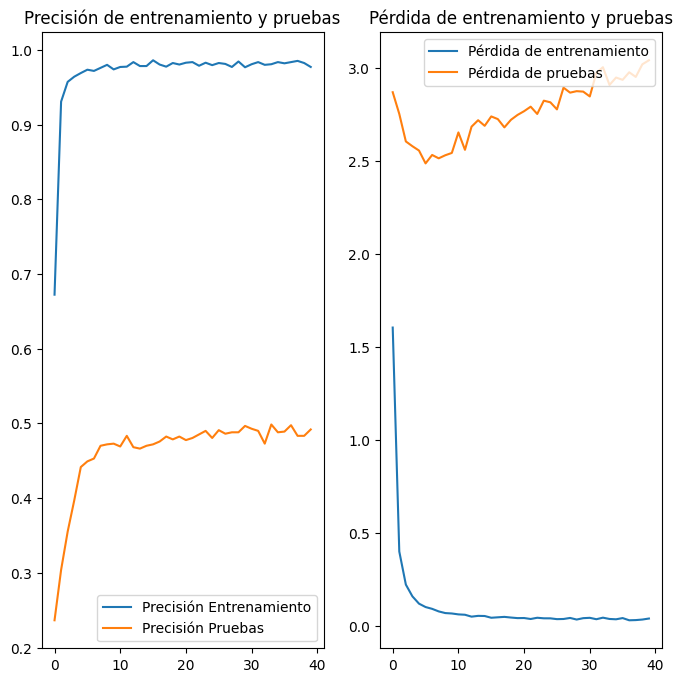

In [13]:
#Graficas de precisión
acc = historial.history['accuracy']
val_acc = historial.history['val_accuracy']

loss = historial.history['loss']
val_loss = historial.history['val_loss']

rango_epocas = range(60)

plt.figure(figsize=(8,8))
plt.subplot(1,2,1)
plt.plot(rango_epocas, acc, label='Precisión Entrenamiento')
plt.plot(rango_epocas, val_acc, label='Precisión Pruebas')
plt.legend(loc='lower right')
plt.title('Precisión de entrenamiento y pruebas')

plt.subplot(1,2,2)
plt.plot(rango_epocas, loss, label='Pérdida de entrenamiento')
plt.plot(rango_epocas, val_loss, label='Pérdida de pruebas')
plt.legend(loc='upper right')
plt.title('Pérdida de entrenamiento y pruebas')
plt.show()

In [27]:
#Categorizar una imagen de internet
from PIL import Image
import requests
from io import BytesIO
import cv2
import numpy as np


def categorizar(url):
  respuesta = requests.get(url)
  img = Image.open(BytesIO(respuesta.content))
  img = np.array(img).astype(float)/255

  img = cv2.resize(img, (224,224))
  prediccion = modelo.predict(img.reshape(-1, 224, 224, 3))

  print(prediccion)
  return np.argmax(prediccion[0], axis=-1), prediccion

In [28]:
url = 'https://previews.123rf.com/images/darakchi/darakchi1610/darakchi161000002/67248782-letra-b-en-lenguaje-de-se%C3%B1as-americano-asl-para-personas-sordas.jpg' #debe ser 1
prediccion, full  = categorizar (url)
print(prediccion)

1/1 [==============================] - 0s 460ms/step
[[2.5834212e-05 9.6330643e-01 3.0041002e-07 5.4581155e-06 9.0215319e-05
  1.3734937e-03 6.1627472e-04 2.1998584e-08 2.6948261e-03 8.3547886e-03
  4.0435112e-05 2.6343782e-06 4.2936321e-05 6.5340981e-04 2.4619867e-06
  2.3085452e-04 3.0062708e-08 2.1333992e-02 3.6199737e-04 7.7443258e-07
  3.1498121e-04 3.8107310e-06 4.3214510e-05 5.2329692e-06 3.1734253e-05
  5.6835177e-07 4.6337189e-04]]
1


In [29]:
url = 'https://i.pinimg.com/236x/0c/67/3d/0c673d36a88e14b9ffdf6ebece255e4c.jpg'
prediccion, full = categorizar (url)
print(prediccion, full)


1/1 [==============================] - 0s 22ms/step
[[0.00778799 0.00075251 0.01227296 0.00581975 0.00198566 0.2649993
  0.00965854 0.07719808 0.04866064 0.00131122 0.00050072 0.00264532
  0.00919793 0.01812212 0.00080009 0.04621095 0.00679817 0.15797497
  0.01227554 0.01894412 0.03935019 0.04906926 0.07258017 0.02952231
  0.08954822 0.00145772 0.01455559]]
5 [[0.00778799 0.00075251 0.01227296 0.00581975 0.00198566 0.2649993
  0.00965854 0.07719808 0.04866064 0.00131122 0.00050072 0.00264532
  0.00919793 0.01812212 0.00080009 0.04621095 0.00679817 0.15797497
  0.01227554 0.01894412 0.03935019 0.04906926 0.07258017 0.02952231
  0.08954822 0.00145772 0.01455559]]


In [30]:
print(prediccion)
result = np.array(full)
print(full[0][1])

prediccion_final = "no se reconoce"
if full[0][1] > 0.8 or full[0][0] > 0.8:
  prediccion_final = prediccion
print(prediccion_final)

5
0.0007525065
no se reconoce


In [31]:
url = 'https://i.pinimg.com/236x/0c/67/3d/0c673d36a88e14b9ffdf6ebece255e4c.jpg'
prediccion = categorizar (url)
print(prediccion)

1/1 [==============================] - 0s 45ms/step
[[0.00778799 0.00075251 0.01227296 0.00581975 0.00198566 0.2649993
  0.00965854 0.07719808 0.04866064 0.00131122 0.00050072 0.00264532
  0.00919793 0.01812212 0.00080009 0.04621095 0.00679817 0.15797497
  0.01227554 0.01894412 0.03935019 0.04906926 0.07258017 0.02952231
  0.08954822 0.00145772 0.01455559]]
(5, array([[0.00778799, 0.00075251, 0.01227296, 0.00581975, 0.00198566,
        0.2649993 , 0.00965854, 0.07719808, 0.04866064, 0.00131122,
        0.00050072, 0.00264532, 0.00919793, 0.01812212, 0.00080009,
        0.04621095, 0.00679817, 0.15797497, 0.01227554, 0.01894412,
        0.03935019, 0.04906926, 0.07258017, 0.02952231, 0.08954822,
        0.00145772, 0.01455559]], dtype=float32))


In [32]:
modelo.save('mm/modelo_entrenado.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [33]:
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import custom_object_scope
import tensorflow_hub as hub

with custom_object_scope({'KerasLayer': hub.KerasLayer}):
    modelo = load_model('mm/modelo_entrenado.h5')

In [34]:
url = 'https://previews.123rf.com/images/torsak/torsak1303/torsak130300214/18724666-finger-escribiendo-el-alfabeto-en-lenguaje-de-se%C3%B1as-americano-asl-la-letra-c.jpg'
prediccion = categorizar (url)
print(prediccion)

1/1 [==============================] - 0s 441ms/step
[[3.5524869e-04 9.1271751e-02 2.4815095e-03 2.4345355e-02 2.1680120e-01
  6.5664791e-02 1.8295184e-02 6.5823691e-04 2.9415013e-03 1.0997197e-02
  8.9721590e-02 4.3735356e-04 6.5303291e-04 6.6780835e-02 1.6527278e-04
  1.4768749e-01 2.0684296e-04 2.4760689e-03 2.1489976e-04 6.1530923e-04
  7.6700537e-03 3.1534099e-04 1.7372865e-04 2.0833268e-04 2.4224021e-01
  1.2789453e-04 6.4937910e-03]]
(24, array([[3.5524869e-04, 9.1271751e-02, 2.4815095e-03, 2.4345355e-02,
        2.1680120e-01, 6.5664791e-02, 1.8295184e-02, 6.5823691e-04,
        2.9415013e-03, 1.0997197e-02, 8.9721590e-02, 4.3735356e-04,
        6.5303291e-04, 6.6780835e-02, 1.6527278e-04, 1.4768749e-01,
        2.0684296e-04, 2.4760689e-03, 2.1489976e-04, 6.1530923e-04,
        7.6700537e-03, 3.1534099e-04, 1.7372865e-04, 2.0833268e-04,
        2.4224021e-01, 1.2789453e-04, 6.4937910e-03]], dtype=float32))
